# Temporal Data Exploration -- A subset of buildings out of the 507 total to show temporal data
- Clayton Miller (miller.clayton@gmail.com)

This notebook is for understanding what is contained in the '/data/raw/temp_open.csv' file through visualizations

In [1]:
import pandas as pd
import seaborn as sns
import os
import matplotlib.pyplot as plt
from datetime import date, timedelta
import numpy as np

In [2]:
%matplotlib inline

Please fill in the following variable with the path on your computer where the repository is contained:

In [3]:
repos_path = "/Users/Clayton/temporal-features-for-buildings/"

In [4]:
temp = pd.read_csv(os.path.join(repos_path,"data/raw/temp_open.csv"), index_col="timestamp", parse_dates=True)

In [5]:
temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40944 entries, 2010-01-01 00:00:00 to 2015-12-31 23:00:00
Columns: 507 entries, PrimClass_Everett to UnivLab_Aoife
dtypes: float64(507)
memory usage: 158.7 MB


In [6]:
temp.head()

,PrimClass_Everett,UnivClass_Clifford,Office_Elizabeth,Office_Ellie,PrimClass_Elisabeth,Office_Cristina,PrimClass_Jolie,PrimClass_Jaylin,Office_Jesus,PrimClass_Esmeralda,...,Office_Pauline,UnivLab_Dianna,UnivDorm_Cecilia,Office_Luann,Office_Milton,Office_Lane,Office_Cameron,UnivLab_Lea,UnivLab_Carlos,UnivLab_Aoife
timestamp,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,763.550,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,741.625,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,726.775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,715.025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,703.600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Get the Meta Data as well to understand the start and stop times and the primary use types of the data

In [7]:
meta = pd.read_csv(os.path.join(repos_path,"data/raw/meta_open.csv"), index_col='uid', parse_dates=["datastart","dataend"], dayfirst=True)

# Plot subplots according to datastart and prim use type

In [8]:
sns.set_style("whitegrid")
sns.set_context(font_scale=1.5)

In [24]:
def plot_buildingtype_zoomedin(meta, temp, primaryusetype):
    metalist = meta.datastart.unique()
    for datastarttime in metalist[:2]:

        to_plot_info = meta[(meta.primaryspaceuse_abbrev == primaryusetype) & (meta.datastart == datastarttime)]
        to_plot_names = to_plot_info.index.sort_values()
        
        print "Plotting "+primaryusetype+" with start time: "+str(datastarttime)
        print "This includes the following buildings: "+str(list(to_plot_names))
        
        # See if there is any data to be plotted
        try:
            length = len(to_plot_names)
            plotsize = length*2.5

            starttime = datastarttime + np.timedelta64(275,'D')
            endtime = to_plot_info.dataend.unique()[0] 

            to_plot_data = temp[to_plot_names].truncate(before=starttime, after=endtime)

            to_plot_data.plot(subplots=True, figsize=(15,plotsize))
            plt.tight_layout()

            starttimestring = str(datastarttime)
            #plt.savefig(os.path.join(repos_path,"reports/figures/overviewlinecharts/"+primaryusetype+"_"+starttimestring[:-19]+"_zoomedin.png"))
            plt.show()

        except:
            print "no data to plot"
            continue

## Primary/Secondary Schools

In [25]:
enddate = meta.T.Office_Abbey.dataend - timedelta(days=275)

In [26]:
str(enddate.date())

'2015-03-31'

Plotting PrimClass with start time: 2012-01-01T08:00:00.000000000+0800
This includes the following buildings: ['PrimClass_Ebony', 'PrimClass_Edmund', 'PrimClass_Edwin', 'PrimClass_Eleanor', 'PrimClass_Eli', 'PrimClass_Elijah', 'PrimClass_Elisabeth', 'PrimClass_Ellen', 'PrimClass_Elliott', 'PrimClass_Elmer', 'PrimClass_Emanuela', 'PrimClass_Emilio', 'PrimClass_Emily', 'PrimClass_Eoghan', 'PrimClass_Ernest', 'PrimClass_Ernesto', 'PrimClass_Ervin', 'PrimClass_Esmeralda', 'PrimClass_Ethan', 'PrimClass_Ethel', 'PrimClass_Eva', 'PrimClass_Everett', 'PrimClass_Evie', 'PrimClass_Ezekiel', 'PrimClass_Ezra']


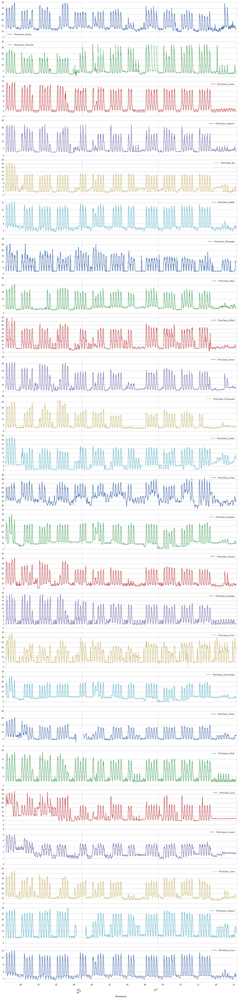

Plotting PrimClass with start time: 2015-01-01T08:00:00.000000000+0800
This includes the following buildings: ['PrimClass_Angel', 'PrimClass_Angela']


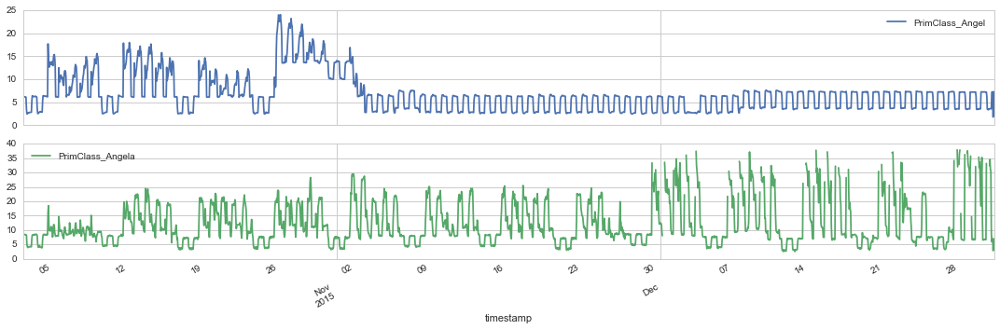

In [27]:
plot_buildingtype_zoomedin(meta, temp, "PrimClass")

# University Classrooms

Plotting UnivClass with start time: 2012-01-01T08:00:00.000000000+0800
This includes the following buildings: ['UnivClass_Beatrice', 'UnivClass_Bob', 'UnivClass_Boyd', 'UnivClass_Brett']


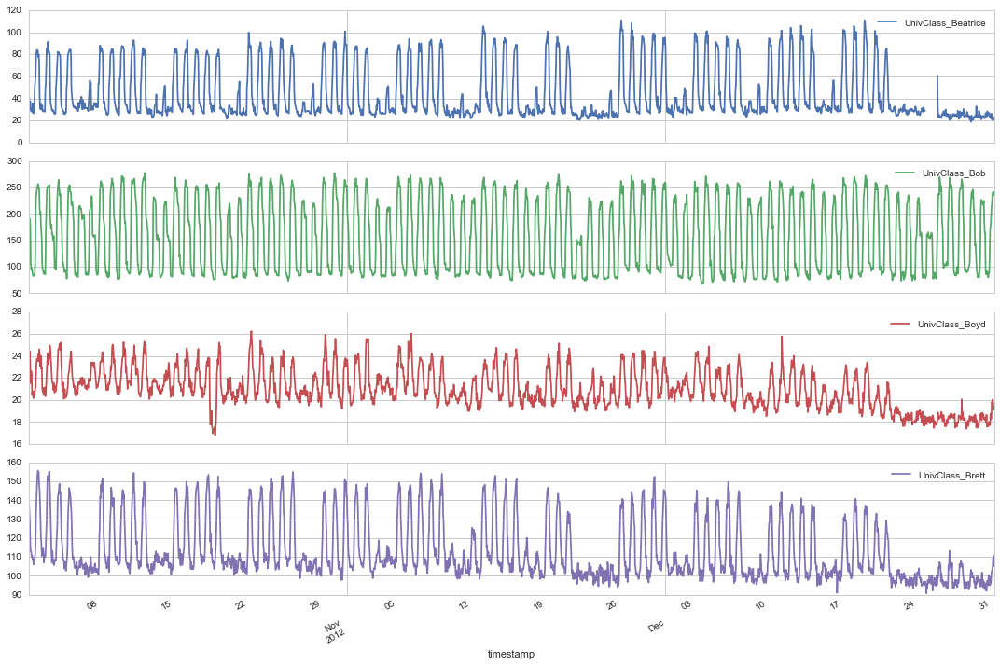

Plotting UnivClass with start time: 2015-01-01T08:00:00.000000000+0800
This includes the following buildings: ['UnivClass_Abby', 'UnivClass_Abraham', 'UnivClass_Adrienne', 'UnivClass_Aidan', 'UnivClass_Alec', 'UnivClass_Alejandra', 'UnivClass_Alexander', 'UnivClass_Alexandra', 'UnivClass_Alexandria', 'UnivClass_Alexus', 'UnivClass_Alfredo', 'UnivClass_Alicia', 'UnivClass_Allen', 'UnivClass_Alvin', 'UnivClass_Amari', 'UnivClass_Amya', 'UnivClass_Anamaria', 'UnivClass_Andy', 'UnivClass_Anika', 'UnivClass_Annabella', 'UnivClass_Anne', 'UnivClass_Annmarie', 'UnivClass_Antoinette', 'UnivClass_Anya', 'UnivClass_Aoibhe', 'UnivClass_Archie', 'UnivClass_Ariana', 'UnivClass_Armando', 'UnivClass_Axel', 'UnivClass_Ayanna', 'UnivClass_Caitlyn', 'UnivClass_Calvin', 'UnivClass_Camden', 'UnivClass_Candy', 'UnivClass_Caoimhe', 'UnivClass_Carl', 'UnivClass_Carolyn', 'UnivClass_Cathleen', 'UnivClass_Celia', 'UnivClass_Chandler', 'UnivClass_Charlie', 'UnivClass_Christian', 'UnivClass_Ciara', 'UnivClass_Cl

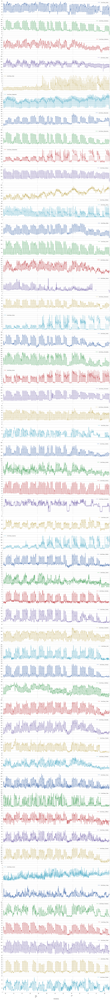

In [28]:
plot_buildingtype_zoomedin(meta, temp, "UnivClass")

# University Labs

Plotting UnivLab with start time: 2012-01-01T08:00:00.000000000+0800
This includes the following buildings: ['UnivLab_Bert', 'UnivLab_Beth', 'UnivLab_Bethany', 'UnivLab_Brad', 'UnivLab_Brenna']


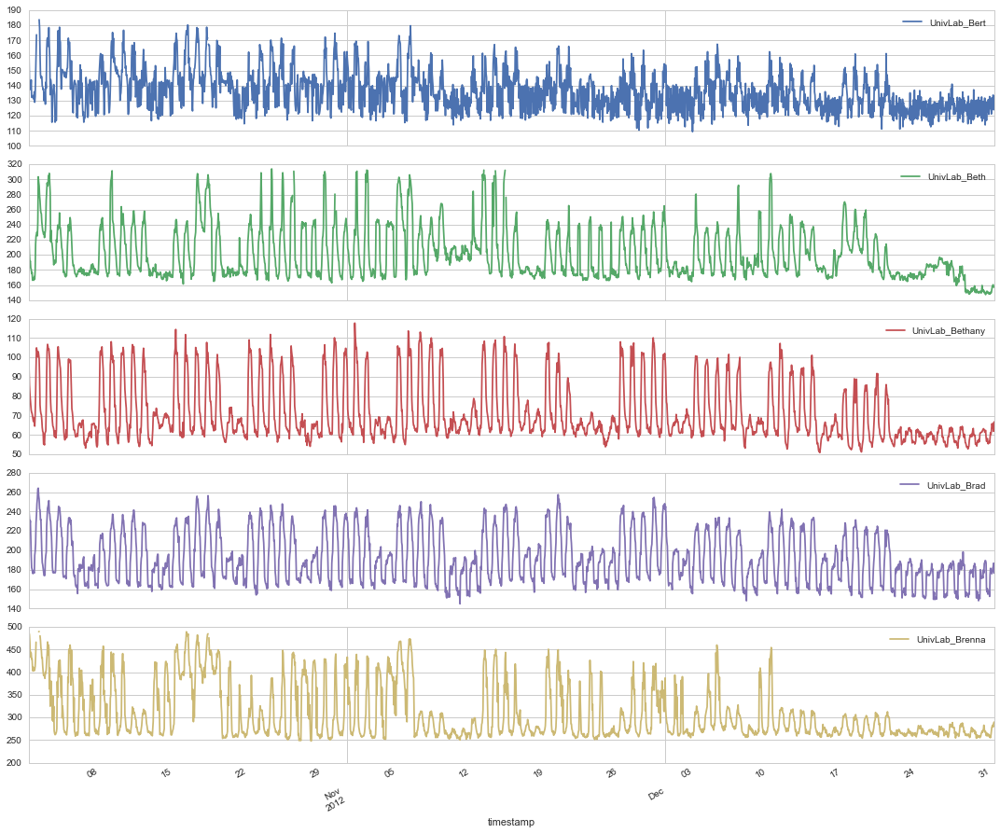

Plotting UnivLab with start time: 2015-01-01T08:00:00.000000000+0800
This includes the following buildings: ['UnivLab_Adrian', 'UnivLab_Aine', 'UnivLab_Alaina', 'UnivLab_Albert', 'UnivLab_Alberto', 'UnivLab_Alexis', 'UnivLab_Alfonso', 'UnivLab_Ali', 'UnivLab_Alina', 'UnivLab_Alisa', 'UnivLab_Allan', 'UnivLab_Allison', 'UnivLab_Amaya', 'UnivLab_Amy', 'UnivLab_Ana', 'UnivLab_Andre', 'UnivLab_Angie', 'UnivLab_Anita', 'UnivLab_Aniya', 'UnivLab_Annabelle', 'UnivLab_Annette', 'UnivLab_Aoife', 'UnivLab_Arianna', 'UnivLab_Ariel', 'UnivLab_Ashlee', 'UnivLab_Ashlynn', 'UnivLab_Ashton', 'UnivLab_Audra', 'UnivLab_Aurora', 'UnivLab_Caesar', 'UnivLab_Caitlin', 'UnivLab_Callie', 'UnivLab_Cam', 'UnivLab_Camryn', 'UnivLab_Carley', 'UnivLab_Carlos', 'UnivLab_Carlton', 'UnivLab_Carol', 'UnivLab_Carole', 'UnivLab_Cayden', 'UnivLab_Cecil', 'UnivLab_Cedric', 'UnivLab_Cesar', 'UnivLab_Cheyanne', 'UnivLab_Christine', 'UnivLab_Christy', 'UnivLab_Ciel', 'UnivLab_Cindy', 'UnivLab_Clint', 'UnivLab_Clodagh', 'Univ

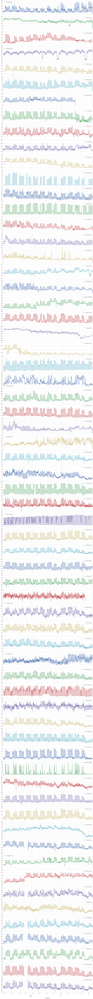

In [29]:
plot_buildingtype_zoomedin(meta, temp, "UnivLab")

# University Dorms

Plotting UnivDorm with start time: 2012-01-01T08:00:00.000000000+0800
This includes the following buildings: []
no data to plot
Plotting UnivDorm with start time: 2015-01-01T08:00:00.000000000+0800
This includes the following buildings: ['UnivDorm_Adan', 'UnivDorm_Adriana', 'UnivDorm_Ahmad', 'UnivDorm_Alex', 'UnivDorm_Alka', 'UnivDorm_Alonzo', 'UnivDorm_Alphonso', 'UnivDorm_Alyshialynn', 'UnivDorm_Alyssa', 'UnivDorm_Antonio', 'UnivDorm_April', 'UnivDorm_Ashleigh', 'UnivDorm_Avery', 'UnivDorm_Camila', 'UnivDorm_Candace', 'UnivDorm_Cara', 'UnivDorm_Carey', 'UnivDorm_Carla', 'UnivDorm_Carter', 'UnivDorm_Casey', 'UnivDorm_Cathal', 'UnivDorm_Cathalina', 'UnivDorm_Cecilia', 'UnivDorm_Celeste', 'UnivDorm_Chelsey', 'UnivDorm_Cheri', 'UnivDorm_Chester', 'UnivDorm_Cheyenne', 'UnivDorm_Christi', 'UnivDorm_Christopher', 'UnivDorm_Cian', 'UnivDorm_Ciaran', 'UnivDorm_Claudia', 'UnivDorm_Clayton', 'UnivDorm_Colton', 'UnivDorm_Constance', 'UnivDorm_Cooper', 'UnivDorm_Corey', 'UnivDorm_Cornelius', 'Uni

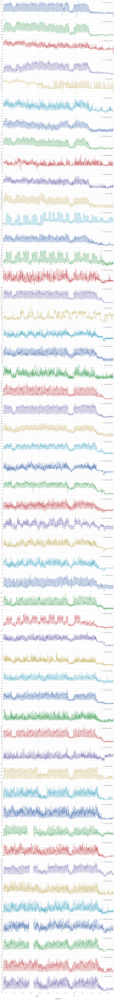

In [30]:
plot_buildingtype_zoomedin(meta, temp, "UnivDorm")

# Offices

Plotting Office with start time: 2012-01-01T08:00:00.000000000+0800
This includes the following buildings: ['Office_Benjamin', 'Office_Benthe', 'Office_Bianca', 'Office_Bobbi', 'Office_Brian', 'Office_Bryon', 'Office_Eddie', 'Office_Eileen', 'Office_Elena', 'Office_Elizabeth', 'Office_Ellie', 'Office_Elliot', 'Office_Ellis', 'Office_Emer', 'Office_Emerald', 'Office_Erik', 'Office_Evelyn']


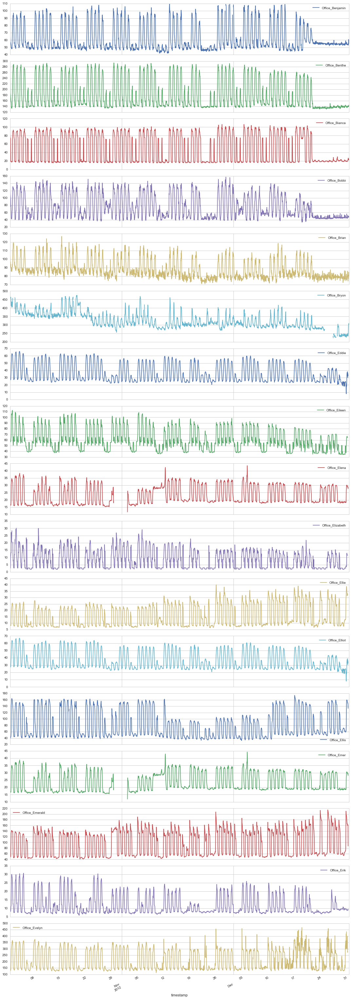

Plotting Office with start time: 2015-01-01T08:00:00.000000000+0800
This includes the following buildings: ['Office_Abbey', 'Office_Abigail', 'Office_Al', 'Office_Alannah', 'Office_Aliyah', 'Office_Allyson', 'Office_Alyson', 'Office_Amelia', 'Office_Amelie', 'Office_Anastasia', 'Office_Andrea', 'Office_Angelica', 'Office_Angelina', 'Office_Angelo', 'Office_Annika', 'Office_Ashanti', 'Office_Asher', 'Office_Aubrey', 'Office_Autumn', 'Office_Ava', 'Office_Ayden', 'Office_Ayesha', 'Office_Caleb', 'Office_Cameron', 'Office_Carissa', 'Office_Carolina', 'Office_Catherine', 'Office_Cecelia', 'Office_Charles', 'Office_Clarissa', 'Office_Clifton', 'Office_Clinton', 'Office_Cody', 'Office_Colby', 'Office_Conrad', 'Office_Cora', 'Office_Corbin', 'Office_Cristina', 'Office_Curt', 'Office_Paige', 'Office_Pam', 'Office_Pamela', 'Office_Pasquale', 'Office_Pat', 'Office_Patricia', 'Office_Paula', 'Office_Paulette', 'Office_Paulina', 'Office_Pauline', 'Office_Penny', 'Office_Perla', 'Office_Phebian', '

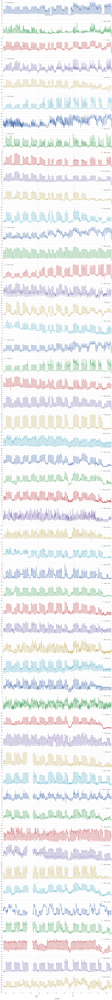

In [31]:
plot_buildingtype_zoomedin(meta, temp, "Office")